### In this notebook

1. Loading the pictures downloaded from the "Amsterdam" instagram page and extracting their features
2. Reducing the dimensionality of the features vector through PCA
3. Clustering the images with K-Means
4. Interpreting the obtained clusters

The pictures have been downloaded using the "Social Helper" extension for Google Chrome.

### Importing necessary libraries

In [25]:
from keras.preprocessing.image import load_img 
from keras.preprocessing.image import img_to_array 
from keras.applications.vgg16 import preprocess_input 

from keras.applications.vgg16 import VGG16 
from keras.models import Model

from sklearn.cluster import KMeans
from sklearn.decomposition import PCA

import os
import numpy as np
import matplotlib.pyplot as plt
from random import randint
import pandas as pd
import pickle

### Creating a list that contains the names of all files

In [26]:
path = "/Users/Federico/Desktop/amsterdam"
os.chdir(path)

pictures = []

with os.scandir(path) as files:
    for file in files:
        if file.name.endswith('.jpg'):
            pictures.append(file.name)

### Loading the model and defining the features-extracting function

In [27]:
model = VGG16()
model = Model(inputs = model.inputs, outputs = model.layers[-2].output)

The images have to be loaded and converted into a 224x224 numpy array (as required by the VGG16 convolutional neural network which will extract the features of each picture).

In [ ]:
def extract_features(file, model):
    img = load_img(file, target_size=(224,224))
    img = np.array(img) 
    # reshape the data (num_of_samples, dim 1, dim 2, channels)
    reshaped_img = img.reshape(1,224,224,3) 
    imgx = preprocess_input(reshaped_img)
    # get the feature vector
    features = model.predict(imgx, use_multiprocessing=True)
    return features

### Looping through each image in the dataset and extracting its features

In [28]:
data = {}
p = r"/Users/Federico/Desktop/Model development"

for picture in pictures:
    try:
        feat = extract_features(picture,model)
        data[picture] = feat
    except:
        with open(p,'wb') as file:
            pickle.dump(data,file)

filenames = np.array(list(data.keys()))

# get a list of just the features
feat = np.array(list(data.values()))
feat = feat.reshape(-1,4096)

### PCA for dimensionality reduction

Since our features vector has 4096 variables, it is better to reduce its dimensionality. We will rely on Principal Component Analysis to do so.

In [29]:
pca = PCA(n_components=100, random_state=22)
pca.fit(feat)
x = pca.transform(feat)

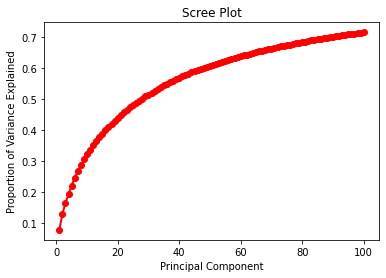

In [31]:
PC_values = np.arange(pca.n_components_) + 1
plt.plot(PC_values, pca.explained_variance_ratio_.cumsum(), 'ro-', linewidth=2)
plt.title('Scree Plot')
plt.xlabel('Principal Component')
plt.ylabel('Proportion of Variance Explained')
plt.show()

The first 100 principal components explain around 70% of the variance created by the data. Retaining a number of principal components that guarantee this amount of explained variance should lead to a good balance between dimensionality and amount of information kept.

### K-Means clustering

#### Finding the optimal number of clusters through the elbow method

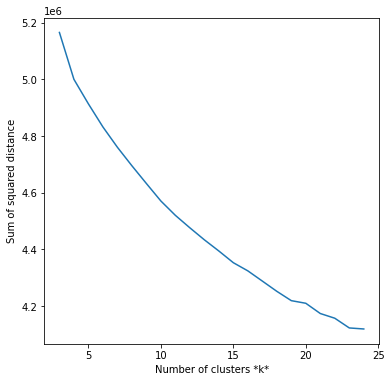

In [30]:
sse = []
list_k = list(range(3, 25))

for k in list_k:
    km = KMeans(n_clusters=k, random_state=22)
    km.fit(x)
    
    sse.append(km.inertia_)

# Plot sse against k
plt.figure(figsize=(6, 6))
plt.plot(list_k, sse)
plt.xlabel(r'Number of clusters *k*')
plt.ylabel('Sum of squared distance');

The elbow method is a heuristic used in determining the number of clusters in a dataset. The method consists of plotting the explained variation as a function of the number of clusters, and picking the elbow of the curve as the number of clusters to use.

We are getting 19 and 23 as candidates for optimal number of clusters. Observing the images in the clusters obtained by testing both possibilities, 23 was found to be more appropriate.

#### Clustering

In [32]:
kmeans = KMeans(n_clusters=23, random_state=22)
kmeans.fit(x)

KMeans(n_clusters=23, random_state=22)

#### Creating a dataframe containing the name of each picture and its cluster label

In [21]:
df = pd.DataFrame({'filenames':filenames, 'label':kmeans.labels_})
df

,filenames,label
0,483_70045129_111066916763834_18643156325865759...,8
1,575_65428513_465994727526246_57392823462754442...,2
2,1318_19436934_1451212988298903_213795275908789...,4
3,655_61704572_172124387143653_66024958379358349...,5
4,708_53220829_418635315375026_84051060832965101...,1
...,...,...
2156,1481_16790219_1172202479545528_188531063656965...,3
2157,1454_17332732_1620764291285549_898971462326760...,20
2158,1822_13108545_477062879151019_1043955847_n.jpg,9
2159,940_36149503_271202803629870_18222661731363061...,22


#### Defining a function which will allow us to visualize the pictures in each cluster

In [33]:
# holds the cluster id and the images { id: [images] }
groups = {}
for file, cluster in zip(filenames,kmeans.labels_):
    if cluster not in groups.keys():
        groups[cluster] = []
        groups[cluster].append(file)
    else:
        groups[cluster].append(file)

In [34]:
def view_cluster(cluster):
    plt.figure(figsize = (25,25));
    # gets the list of filenames for a cluster
    files = groups[cluster]
    # only allow up to 30 images to be shown at a time
    if len(files) > 30:
        print(f"Clipping cluster size from {len(files)} to 30")
        files = files[:29]
    # plot each image in the cluster
    for index, file in enumerate(files):
        plt.subplot(10,10,index+1);
        img = load_img(file)
        img = np.array(img)
        plt.imshow(img)
        plt.axis('off')

### Interpretation

As in any unsupervised machine learning project, we need to interpret the results. In this case, the images have been grouped on the basis of visual similarities that can relate to subjects in the foreground or background, colors, geometric shapes and so on. The algorithm can therefore group some images that apparently have nothing in common, but by looking carefully it is possible to discover the main identified patterns.

Cluster 0: Buildings overlooking the canals

Clipping cluster size from 98 to 30


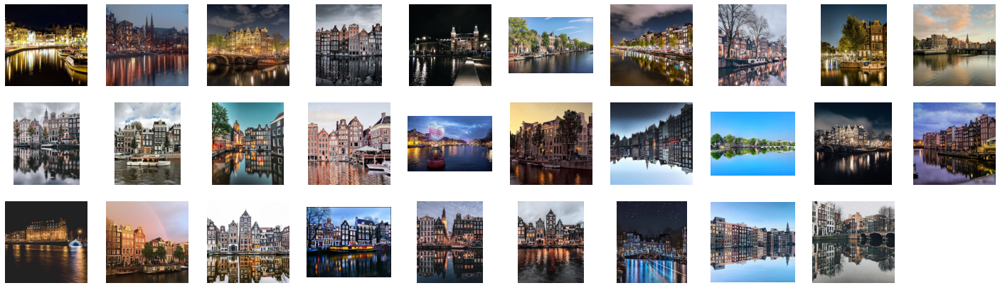

In [36]:
view_cluster(0)

Cluster 1: Bikes

Clipping cluster size from 72 to 30


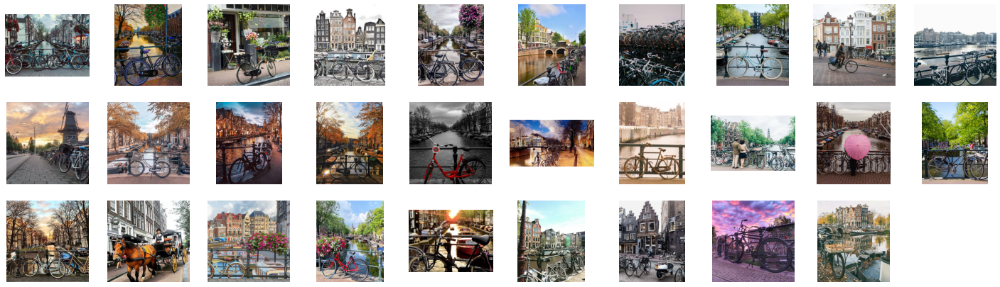

In [37]:
view_cluster(1)

Cluster 2: Big buildings

Clipping cluster size from 133 to 30


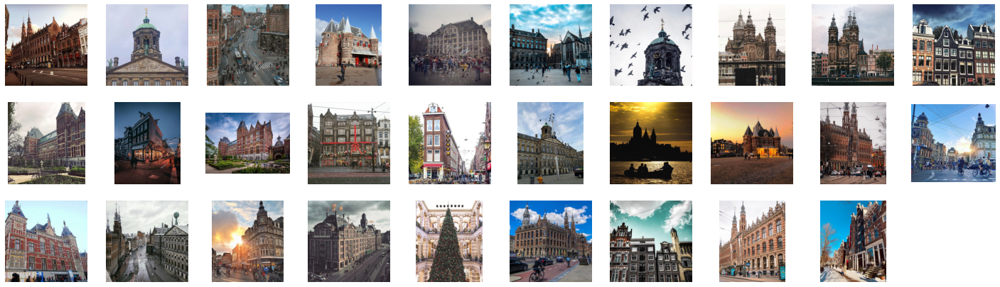

In [38]:
view_cluster(2)

Cluster 3: Deep perspectives

Clipping cluster size from 151 to 30


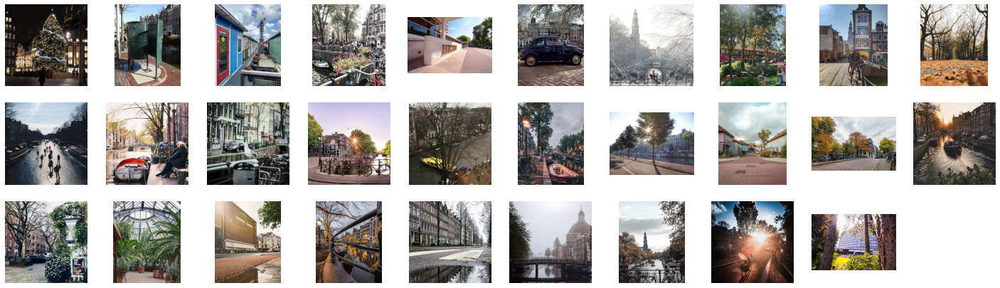

In [39]:
view_cluster(3)

Cluster 4: Areas of the city seen from afar

Clipping cluster size from 86 to 30


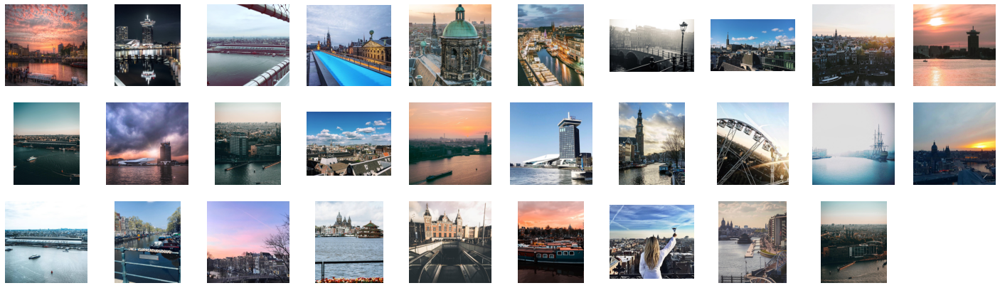

In [40]:
view_cluster(4)

Cluster 5: Buildings overlooking the canals together with trees

Clipping cluster size from 139 to 30


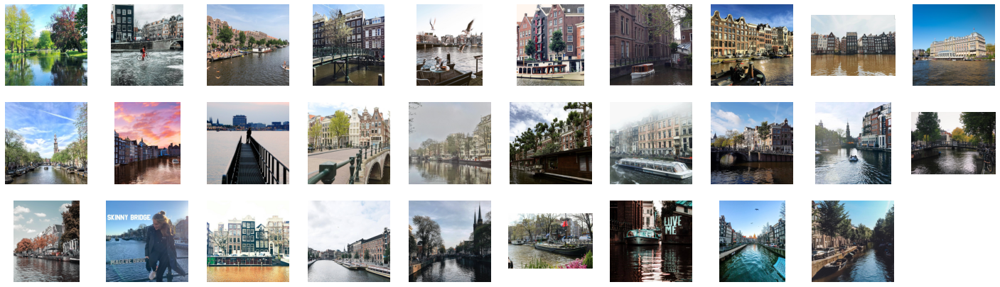

In [63]:
view_cluster(5)

Cluster 6: Buildings with cars or cyclists

Clipping cluster size from 124 to 30


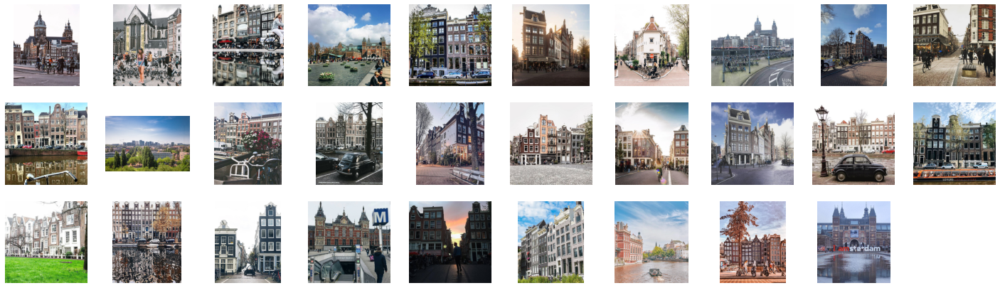

In [64]:
view_cluster(6)

Cluster 7: People

Clipping cluster size from 123 to 30


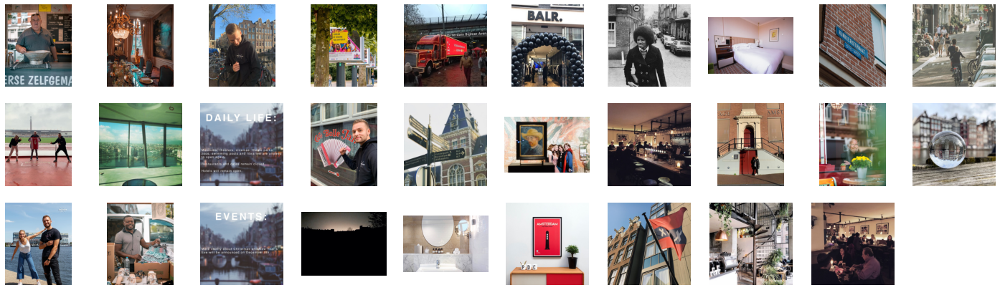

In [48]:
view_cluster(7)

Cluster 8: Pinnacles or other surmounting objects

Clipping cluster size from 131 to 30


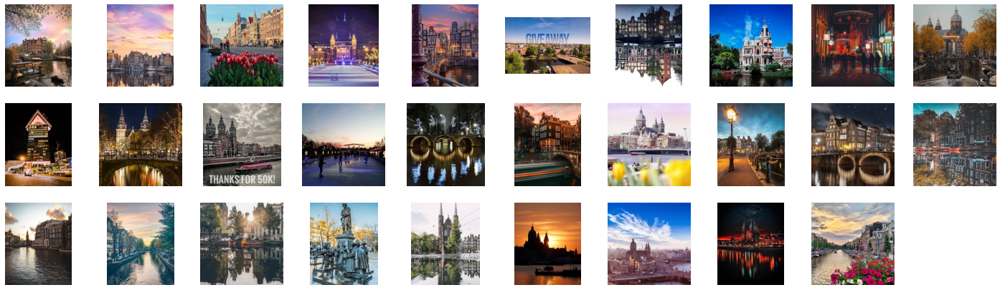

In [65]:
view_cluster(8)

Cluster 9: City seen from above

Clipping cluster size from 76 to 30


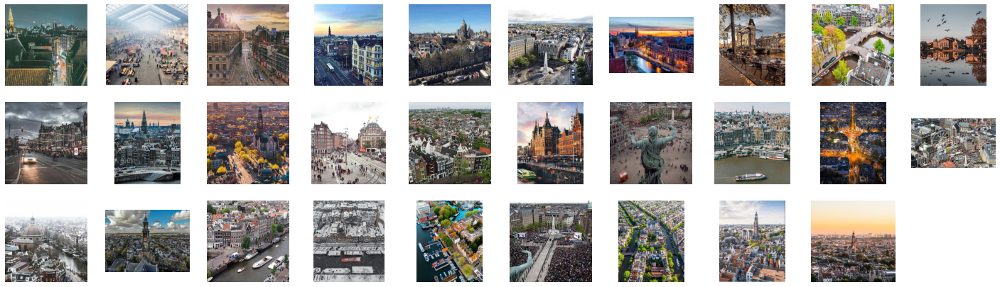

In [66]:
view_cluster(9)

Cluster 10: Boats in the background

Clipping cluster size from 100 to 30


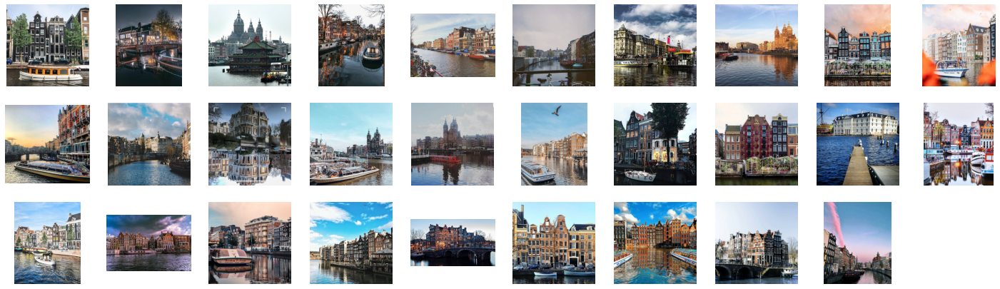

In [46]:
view_cluster(10)

Cluster 11: Crowds of people

Clipping cluster size from 50 to 30


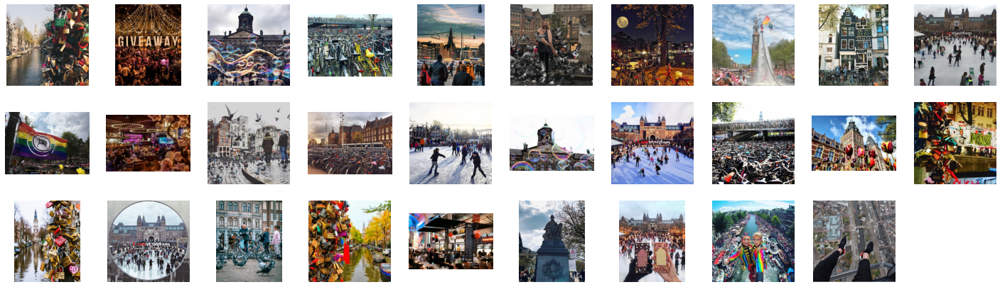

In [47]:
view_cluster(11)

Cluster 12: Trams

Clipping cluster size from 68 to 30


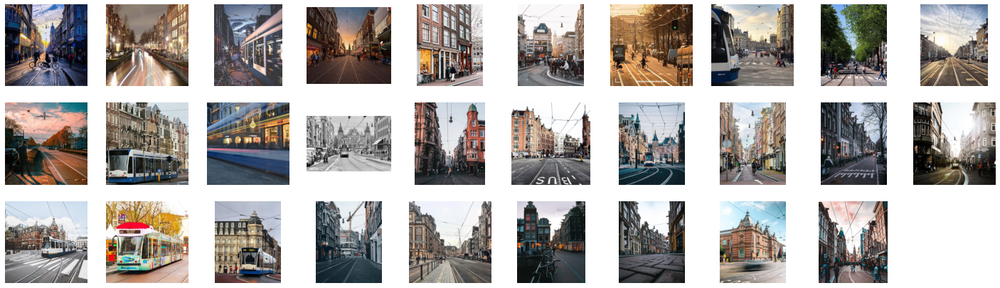

In [49]:
view_cluster(12)

Cluster 13: Bridges

Clipping cluster size from 64 to 30


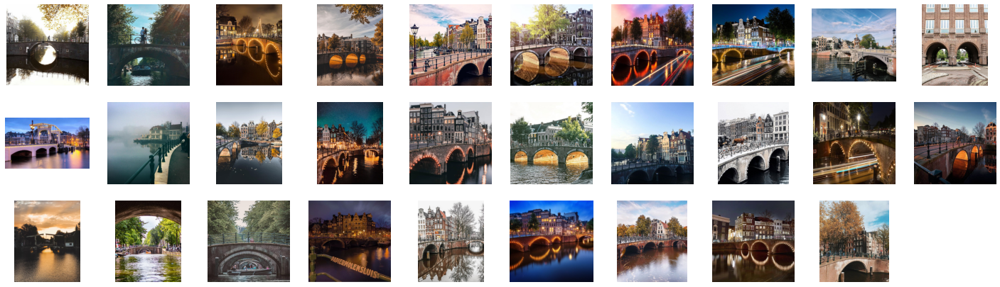

In [50]:
view_cluster(13)

Cluster 14: Subjects seen from below or from above

Clipping cluster size from 69 to 30


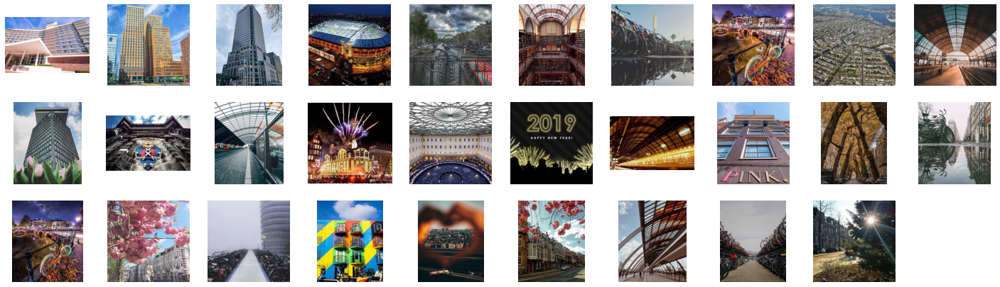

In [51]:
view_cluster(14)

Cluster 15: Buildings overlooking the canals in perspective

Clipping cluster size from 63 to 30


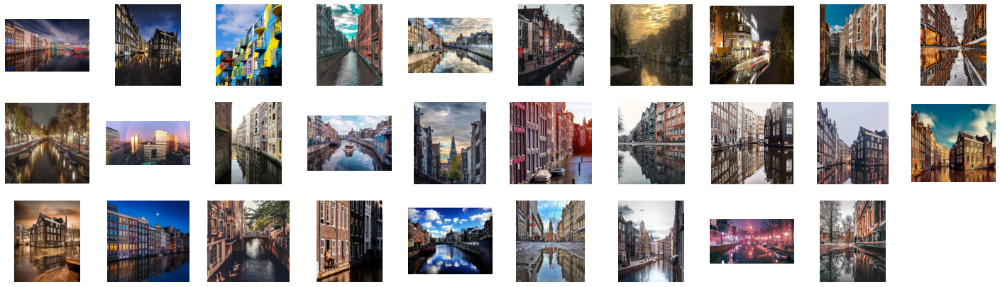

In [53]:
view_cluster(15)

Cluster 16: Buildings overlooking the streets in perspective

Clipping cluster size from 149 to 30


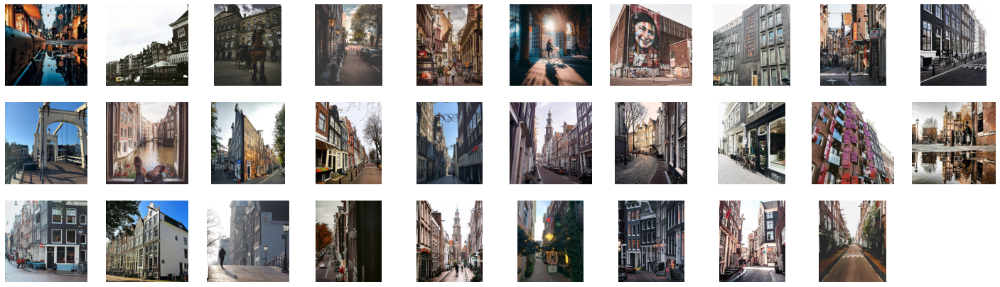

In [54]:
view_cluster(16)

Cluster 17: Cables, poles and other long and thin objects (often people on swings)

Clipping cluster size from 47 to 30


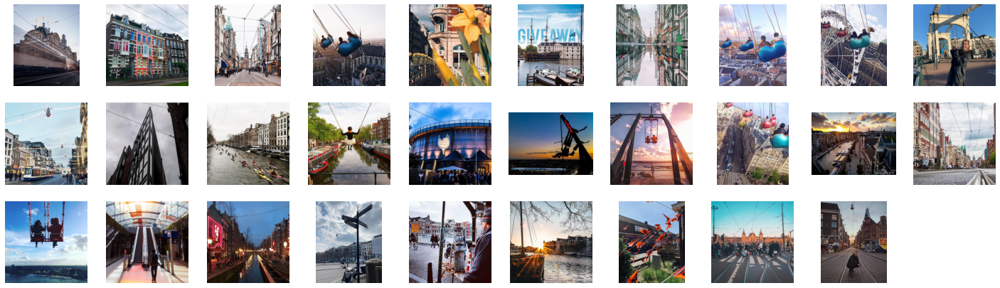

In [55]:
view_cluster(17)

Cluster 18: Boats in the foreground

Clipping cluster size from 60 to 30


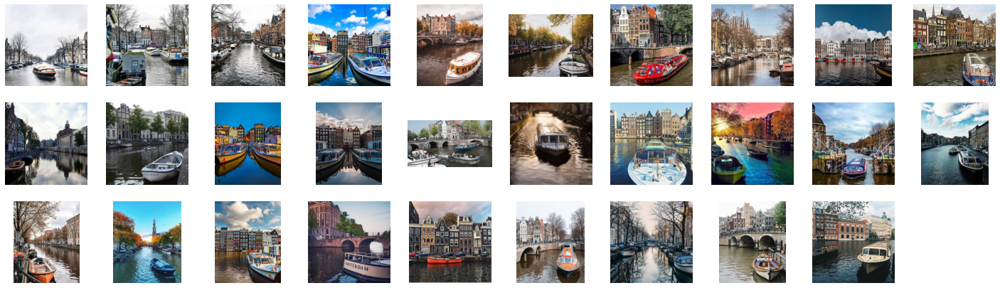

In [56]:
view_cluster(18)

Cluster 19: Canals and trees (or other vegetation), mainly in autumn

Clipping cluster size from 138 to 30


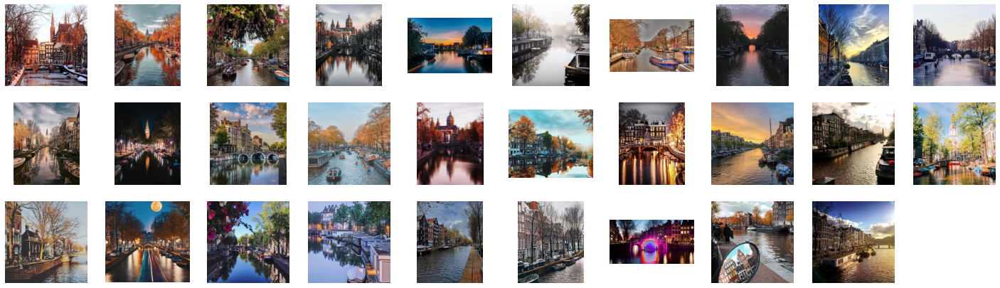

In [57]:
view_cluster(19)

Cluster 20: Buildings seen from the front

Clipping cluster size from 89 to 30


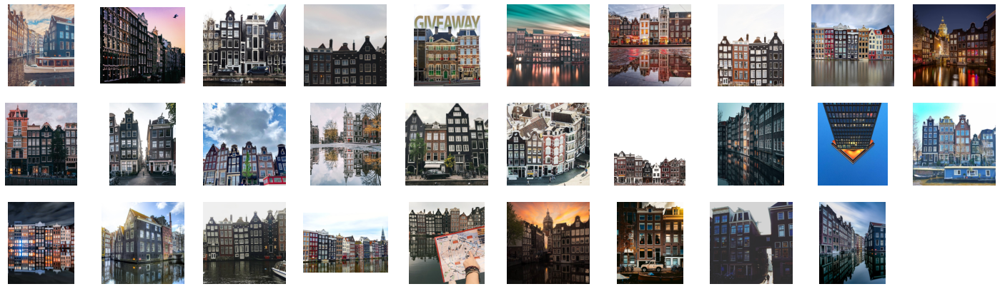

In [58]:
view_cluster(20)

Cluster 21: Flowers in the foreground

Clipping cluster size from 53 to 30


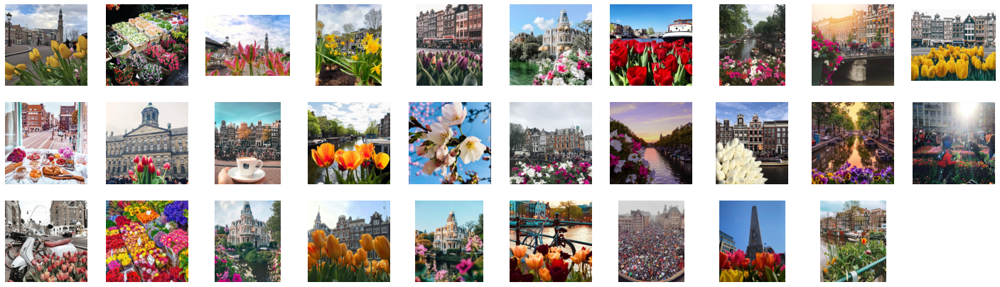

In [59]:
view_cluster(21)

Cluster 22: Food in the foreground (often hand held)

Clipping cluster size from 78 to 30


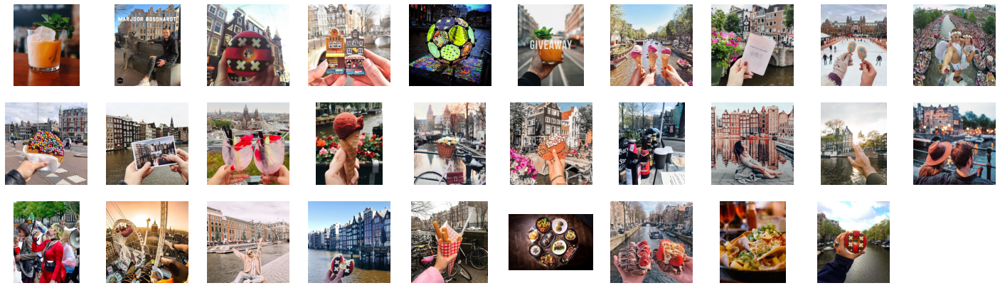

In [61]:
view_cluster(22)